<a href="https://colab.research.google.com/github/rae-gh/colab-analyses/blob/main/Density_Intro.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1>Density at high resolution - examples</h1>
(c) Rachel Alcraft 2024

<hr/>
</br> 1. RUN: Import the required librarires
</br> 2. Each cell is self contained to run with an example
<hr/>

In [ ]:
# CELL 1
# PATH TO YOUR SAMPLE DATA (pdbs, results, etc.)
# NOTE if you are using colab there is a deirectory by default called sample_data
# If you are running locally with jupyter notebook choose a directory of your choice

DATADIR = "sample_data/"
IS_GOOGLE_COLAB = True  # Set this to True if you are using Google Colab

In [1]:
# CELL 2
# Need to import libraries
if IS_GOOGLE_COLAB:  
  try:#runtime gets refreshed so reinstall of non standard libraries may be necessary
    import google.colab    
    !pip install maptial        
  except:
    pass
else:
  print("Not using Google Colab, so make sure you have an environment setup with the correct libraries installed, e.g.\n------------------")
  print("mamba create -n maptial-env python=3.12 ipykernel ipython nbformat")
  print("mamba activate maptial-env")
  print("python -m pip install maptial")

New interper, Fos= 2 Fcs= -1 mains= 1 diffs= 0
Interpolator: linear (120, 228, 104)
Mean= 8.058659904628339e-10
Std= 1.0397230851635662
Min= -1.9274219274520874
Max= 58.285614013671875


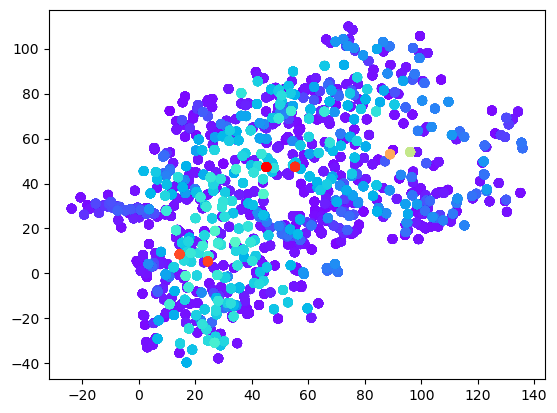

In [25]:
# An example of the projection of 1ejg in the xy plane
###### Enter the pdb #######################
pdb_code = "1ejg"
plane = "xy"
DATADIR = "sample_data/"
##########################################
import leuci_map.mapsmanager as mman
import leuci_map.mapfunctions as mfun
import matplotlib.pyplot as plt
ml = mman.MapsManager().get_or_create(pdb_code,file=1,header=1,values=1)
mf = mfun.MapFunctions(pdb_code,ml.mobj,ml.pobj,"nearest")
valsxy = mf.get_map_projection("xy")
xs,ys,zs,vs,xx,yy,zz = mf.get_atoms_projection("linear",log_level=1)
plt.scatter(ys,xs, c=vs,cmap="rainbow")

New interper, Fos= 2 Fcs= -1 mains= 1 diffs= 0
Interpolator: linear (144, 144, 144)
Mean= -4.998226367923415e-11
Std= 0.07922392355984043
Min= -0.44826099276542664
Max= 0.5697929859161377


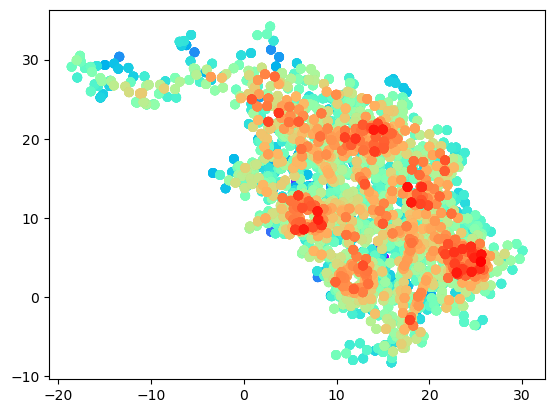

In [24]:
# An example of the projection of 1ejg in the xy plane
###### Enter the pdb #######################
pdb_code = "6q53"
plane = "xy"
DATADIR = "sample_data/"
##########################################
import leuci_map.mapsmanager as mman
import leuci_map.mapfunctions as mfun
import matplotlib.pyplot as plt
ml = mman.MapsManager().get_or_create(pdb_code,file=1,header=1,values=1)
mf = mfun.MapFunctions(pdb_code,ml.mobj,ml.pobj,"nearest")
valsxy = mf.get_map_projection("xy")
xs,ys,zs,vs,xx,yy,zz = mf.get_atoms_projection("linear",log_level=1)
plt.scatter(ys,xs, c=vs,cmap="rainbow")

In [40]:
# And example of rings in disulfide bonds
###### Edit the pdb and the atoms ######
pdb_code = "1ejg"
central_atoms = ["A:3@SG.A","A:4@SG.A","A:16@SG.A"]
linear_atoms = ["A:40@SG.A","A:32@SG.A","A:26@SG.A"]
planar_atoms = ["A:3@O.A","A:4@O.A","A:16@O.A"]
interpolation = "bspline"
width = 10 #Angstrom
samples = 200
#### ----------- ###
from leuci_xyz import vectorthree as v3
import leuci_map.mapsmanager as mman
import leuci_map.mapfunctions as mfun
DATADIR = "sample_data/"
mman.MapsManager().set_dir(DATADIR)
ml = mman.MapsManager().get_or_create(pdb_code,file=1,header=1,values=1)
mf = mfun.MapFunctions(pdb_code,ml.mobj,ml.pobj,interpolation)
slice_vectors = []
for i in range(len(central_atoms)):
  central_atom = central_atoms[i]
  linear_atom = linear_atoms[i]
  planar_atom = planar_atoms[i]  
  cc = v3.VectorThree().from_coords(ml.pobj.get_coords_key(central_atom))
  ll = v3.VectorThree().from_coords(ml.pobj.get_coords_key(linear_atom))
  pp = v3.VectorThree().from_coords(ml.pobj.get_coords_key(planar_atom))
  slice_vectors.append((cc,ll,pp))  
import leuci_map.mapplothelp as mph
filename = "SHOW"
for cc,ll,pp in slice_vectors:  
  vals2d = mf.get_slice(cc,ll,pp,width,samples,interpolation,deriv=0,ret_type="2d")
  mplot = mph.MapPlotHelp(filename)
  mplot.make_plot_slice_2d(vals2d,min_percent=1,max_percent=0.1,samples=samples,width=width,points=[cc,ll,pp],title=pdb_code, plot_type="heatmap", hue="WB")


In [47]:
# And example of difference density in a disulfide bond
###### Edit the pdb and the atoms ######
pdb_code = "1ejg"
central_atom = "A:3@SG.A"
linear_atom = "A:40@SG.A"
planar_atom = "A:3@O.A"
interpolation = "bspline"
width = 6 #Angstrom
samples = 100
#### ----------- ###
from leuci_xyz import vectorthree as v3
import leuci_map.mapsmanager as mman
import leuci_map.mapfunctions as mfun
import leuci_map.mapplothelp as mph
DATADIR = "sample_data/"
mman.MapsManager().set_dir(DATADIR)
ml = mman.MapsManager().get_or_create(pdb_code,file=1,header=1,values=1)
mf = mfun.MapFunctions(pdb_code,ml.mobj,ml.pobj,interpolation,fo=1,fc=-1)
central_atom = central_atom
linear_atom = linear_atom
planar_atom = planar_atom
cc = v3.VectorThree().from_coords(ml.pobj.get_coords_key(central_atom))
ll = v3.VectorThree().from_coords(ml.pobj.get_coords_key(linear_atom))
pp = v3.VectorThree().from_coords(ml.pobj.get_coords_key(planar_atom))
vals2d = mf.get_slice(cc,ll,pp,width,samples,interpolation,deriv=0,ret_type="2d",fo=1,fc=-1)
mplot = mph.MapPlotHelp("SHOW")
mplot.make_plot_slice_2d(vals2d,min_percent=1,max_percent=1,samples=samples,width=width,points=[cc,ll,pp],title=pdb_code, plot_type="contour", hue="RB")

In [12]:
# 3d exploration of the difference density around the SG atom of a disulfide bond
# CELL 5
# 3d plot


pdb_code = "1ejg"
central_atom = "A:3@SG.A"
linear_atom = "A:40@SG.A"
planar_atom = "A:3@O.A"
interpolation = "bspline"
width = 4 #Angstrom
samples = 50
#### ----------- ###
from leuci_xyz import vectorthree as v3
import leuci_map.mapsmanager as mman
import leuci_map.mapfunctions as mfun
import leuci_map.mapplothelp as mph
DATADIR = "../sample_data/"
mman.MapsManager().set_dir(DATADIR)
ml = mman.MapsManager().get_or_create(pdb_code,file=1,header=1,values=1)
mf = mfun.MapFunctions(pdb_code,ml.mobj,ml.pobj,interpolation,fo=1,fc=-1)
cc = v3.VectorThree().from_coords(ml.pobj.get_coords_key(central_atom))
ll = v3.VectorThree().from_coords(ml.pobj.get_coords_key(linear_atom))
pp = v3.VectorThree().from_coords(ml.pobj.get_coords_key(planar_atom))
vals3d,coords = mf.get_slice(cc,ll,pp,width,samples,interpolation,deriv=0,depth_samples=10,ret_type="3d",fo=1,fc=-1)
mplot = mph.MapPlotHelp("SHOW")
mplot.make_plot_slice_3d(vals3d,min_percent=1, max_percent=1,title=pdb_code, hue="RB")

50 50 10


In [2]:
# And example disulfide bonds in 7uly an electron crystallography structure
###### Edit the pdb and the atoms ######
pdb_code = "7uly"
central_atoms = ["A:6@SG.A","A:30@SG.A","A:64@SG.A","A:76@SG.A"]
linear_atoms = ["A:127@SG.A","A:115@SG.A","A:80@SG.A","A:94@SG.A"]
planar_atoms = ["A:6@O.A","A:30@O.A","A:64@O.A","A:76@O.A"]
interpolation = "bspline"
width = 8 #Angstrom
samples = 200
#### ----------- ###
from leuci_xyz import vectorthree as v3
import leuci_map.mapsmanager as mman
import leuci_map.mapfunctions as mfun
DATADIR = "../sample_data/"
mman.MapsManager().set_dir(DATADIR)
ml = mman.MapsManager().get_or_create(pdb_code,file=1,header=1,values=1)
mf = mfun.MapFunctions(pdb_code,ml.mobj,ml.pobj,interpolation)
slice_vectors = []
for i in range(len(central_atoms)):
  central_atom = central_atoms[i]
  linear_atom = linear_atoms[i]
  planar_atom = planar_atoms[i]  
  cc = v3.VectorThree().from_coords(ml.pobj.get_coords_key(central_atom))
  ll = v3.VectorThree().from_coords(ml.pobj.get_coords_key(linear_atom))
  pp = v3.VectorThree().from_coords(ml.pobj.get_coords_key(planar_atom))
  slice_vectors.append((cc,ll,pp))  
import leuci_map.mapplothelp as mph
filename = "SHOW"
for cc,ll,pp in slice_vectors:  
  vals2d = mf.get_slice(cc,ll,pp,width,samples,interpolation,deriv=0,ret_type="2d")
  mplot = mph.MapPlotHelp(filename)
  mplot.make_plot_slice_2d(vals2d,min_percent=1,max_percent=0.7,samples=samples,width=width,points=[cc,ll,pp],title=pdb_code, plot_type="heatmap", hue="WB")


In [4]:


# An example peptide bonds in 7uly an electron crystallography structure
###### Edit the pdb and the atoms ######
pdb_code = "7uly"
central_atoms = ["A:5@C.A","A:6@C.A","A:7@C.A","A:8@C.A"]
linear_atoms = ["A:5@CA.A","A:6@CA.A","A:7@CA.A","A:8@CA.A"]
planar_atoms = ["A:5@O.A","A:6@O.A","A:7@O.A","A:8@O.A"]
interpolation = "bspline"
width = 4.5 #Angstrom
samples = 50
#### ----------- ###
from leuci_xyz import vectorthree as v3
import leuci_map.mapsmanager as mman
import leuci_map.mapfunctions as mfun
DATADIR = "../sample_data/"
mman.MapsManager().set_dir(DATADIR)
ml = mman.MapsManager().get_or_create(pdb_code,file=1,header=1,values=1)
mf = mfun.MapFunctions(pdb_code,ml.mobj,ml.pobj,interpolation)
slice_vectors = []
for i in range(len(central_atoms)):
  central_atom = central_atoms[i]
  linear_atom = linear_atoms[i]
  planar_atom = planar_atoms[i]  
  cc = v3.VectorThree().from_coords(ml.pobj.get_coords_key(central_atom))
  ll = v3.VectorThree().from_coords(ml.pobj.get_coords_key(linear_atom))
  pp = v3.VectorThree().from_coords(ml.pobj.get_coords_key(planar_atom))
  slice_vectors.append((cc,ll,pp))  
import leuci_map.mapplothelp as mph
filename = "SHOW"
for cc,ll,pp in slice_vectors:  
  vals2d = mf.get_slice(cc,ll,pp,width,samples,interpolation,deriv=0,ret_type="2d")
  mplot = mph.MapPlotHelp(filename)
  mplot.make_plot_slice_2d(vals2d,min_percent=1,max_percent=0.9,samples=samples,width=width,points=[cc,ll,pp],title=pdb_code)